In [1]:
import matplotlib.pyplot as plt
import shap
import pickle
import cloudpickle
import numpy as np
from comparers import ModelComparer
from explainers import generate_shap_explanations
from plots import plot_decision_boundary, plot_2d, plot_feature_importance_bar, plot_feature_importance_scatter,\
                  plot_feature_effects, plot_forces
from util import calc_feature_order, calc_class_order, calc_instance_order
from sklearn.utils import resample
from sklearn.linear_model import LogisticRegression
from helper_models import ModifiedClassifier, round_with_precision
shap.initjs()
%matplotlib inline
task_name = '03'
sample_explain_data = None

In [2]:
try:
    with open(task_name + '.models', 'rb') as f:
        comparer = pickle.load(f)
    with open(task_name + '.expl', 'rb') as f:
        explanations = pickle.load(f)
    print('loaded saved state')
except FileNotFoundError:
    pass

loaded saved state


# Setup Task

In [3]:
X, y = shap.datasets.adult()
feature_names = np.array(X.columns)
X = X.values
display_data = shap.datasets.adult(display=True)[0].values
n_features = len(feature_names)
n_samples = X.shape[0]

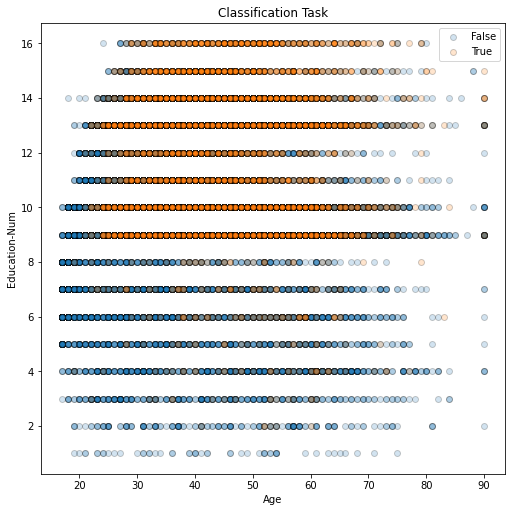

In [4]:
fig, ax = plt.subplots(figsize=(7, 7), constrained_layout=True)
plot_decision_boundary(X, y, 'Classification Task', feature_names,
                       X_display=display_data, idx_x=0, idx_y=2, fig=fig, ax=ax, alpha=0.2)

In [5]:
%%time
class MyModifiedClassifier(ModifiedClassifier):
    def _preprocess(self, X):
        return round_with_precision(X, 1.2)
    
clf_a = LogisticRegression(C=1.0, max_iter=10000)
clf_a.fit(X, y)
clf_b = MyModifiedClassifier(clf_a)
clf_b.fit(X, y)
comparer = ModelComparer(clf_a, clf_b, feature_names)
comparer.fit(X, y)
with open(task_name + '.models', 'wb') as f:
    cloudpickle.dump(comparer, f, pickle.HIGHEST_PROTOCOL)

CPU times: user 17.3 s, sys: 1.69 s, total: 19 s
Wall time: 11.4 s


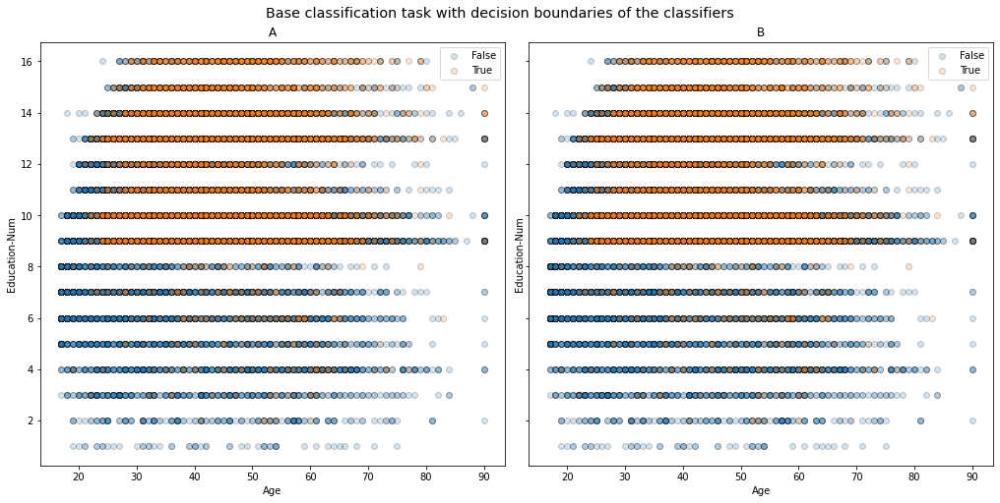

In [6]:
comparer.plot_individual_clf_decision_boundaries(X, display_data, y, kind='label', idx_x=0, idx_y=2, alpha=0.2)

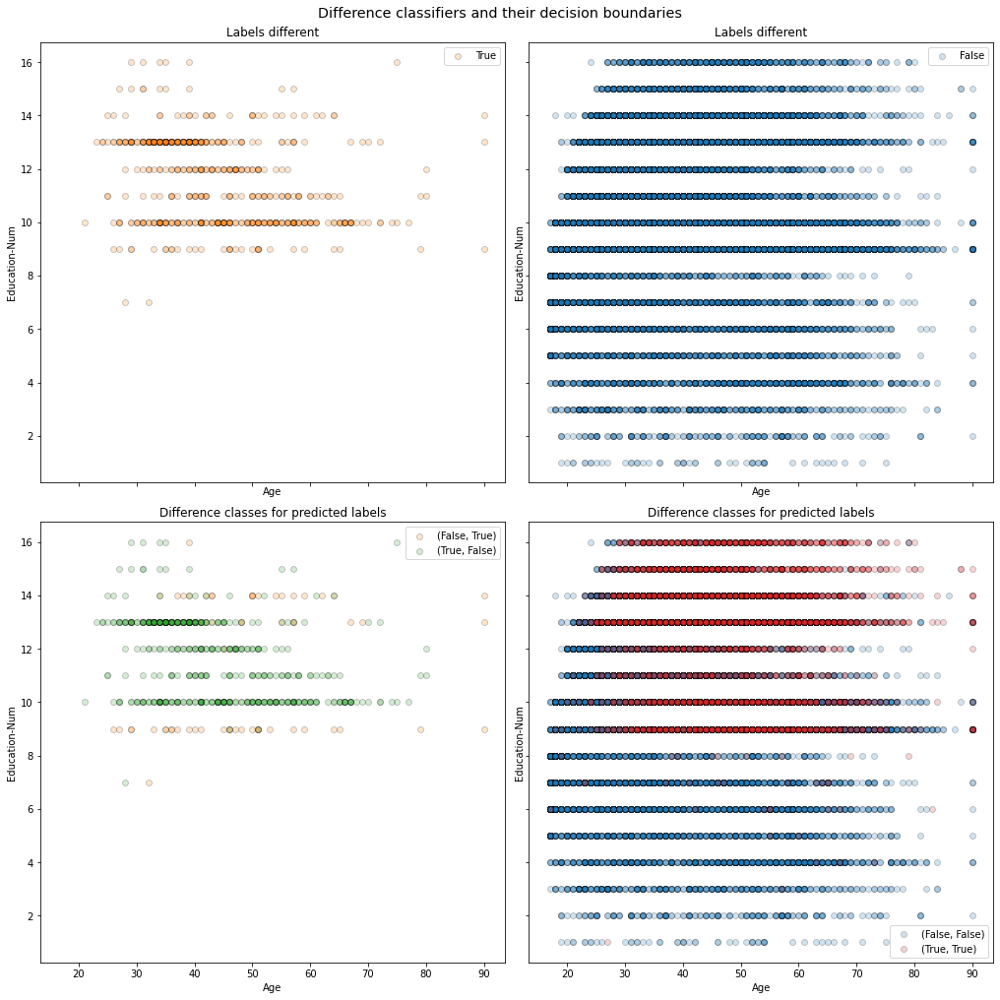

In [7]:
comparer.plot_decision_boundaries(X, display_data, kind='label', idx_x=0, idx_y=2, separate=True, alpha=0.2)

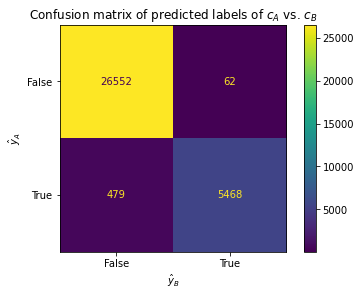

In [8]:
comparer.plot_confusion_matrix(X)

# Explain using Interpretability Methods

In [9]:
if sample_explain_data is not None:
    # stratified sample across diff classes
    mclass_diff = comparer.predict_mclass_diff(X)
    X_explain, display_data_explain, y_explain = resample(X, display_data, y,
                                                          n_samples=sample_explain_data, replace=False,
                                                          stratify=mclass_diff, random_state=0)
    comparer.plot_confusion_matrix(X_explain)
else:
    X_explain, display_data_explain, y_explain = X, display_data, y

In [10]:
%%time
explanations = generate_shap_explanations(comparer, X_explain, display_data_explain)
with open(task_name + '.expl', 'wb') as f:
    pickle.dump(explanations, f, pickle.HIGHEST_PROTOCOL)

Permutation explainer: 32562it [05:32, 96.51it/s]                            
Permutation explainer: 32562it [04:29, 116.38it/s]
Permutation explainer: 32562it [03:54, 133.11it/s]                           
Permutation explainer: 32562it [04:23, 118.46it/s]
Permutation explainer:   4%|▍         | 1238/32561 [00:14<05:09, 101.19it/s]divide by zero encountered in log
divide by zero encountered in log
Permutation explainer:   5%|▍         | 1615/32561 [00:17<05:26, 94.71it/s]divide by zero encountered in log
invalid value encountered in subtract
invalid value encountered in subtract
divide by zero encountered in log
Permutation explainer:   7%|▋         | 2312/32561 [00:25<05:16, 95.58it/s]divide by zero encountered in log
divide by zero encountered in log
invalid value encountered in subtract
invalid value encountered in subtract
divide by zero encountered in log
Permutation explainer:   7%|▋         | 2362/32561 [00:25<05:14, 95.96it/s]divide by zero encountered in log
invalid value enc

CPU times: user 1h 53min 47s, sys: 11min 13s, total: 2h 5min
Wall time: 1h 6min 14s


## Visualize SHAP values

### Individual explanations

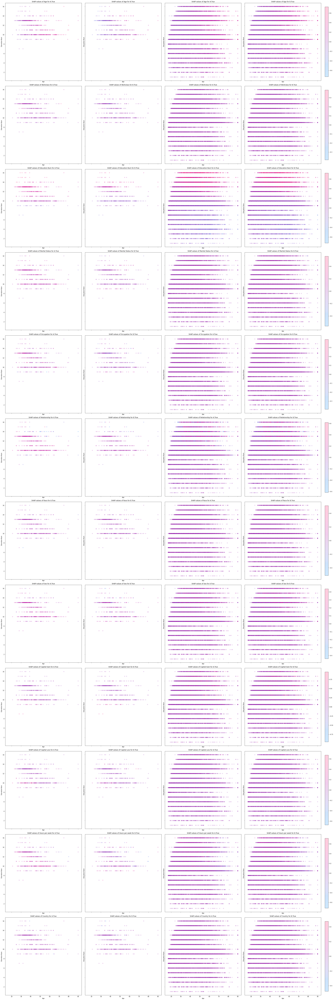

In [11]:
is_pred_diff = comparer.predict_bin_diff(explanations.data)
plot_2d(explanations.indiv.labels[is_pred_diff, :, 1], explanations.indiv.labels[~is_pred_diff, :, 1], x='Age', y='Education-Num', alpha=0.2)

### Simple subtraction explanation

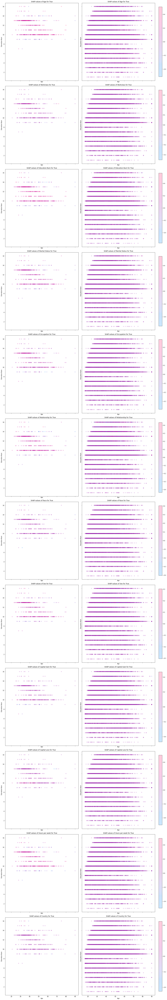

In [12]:
plot_2d(explanations.indiv_diff.labels[is_pred_diff, :, 'True'], explanations.indiv_diff.labels[~is_pred_diff, :, 'True'], x='Age', y='Education-Num', alpha=0.2)

### Multiclass difference classifier explanations

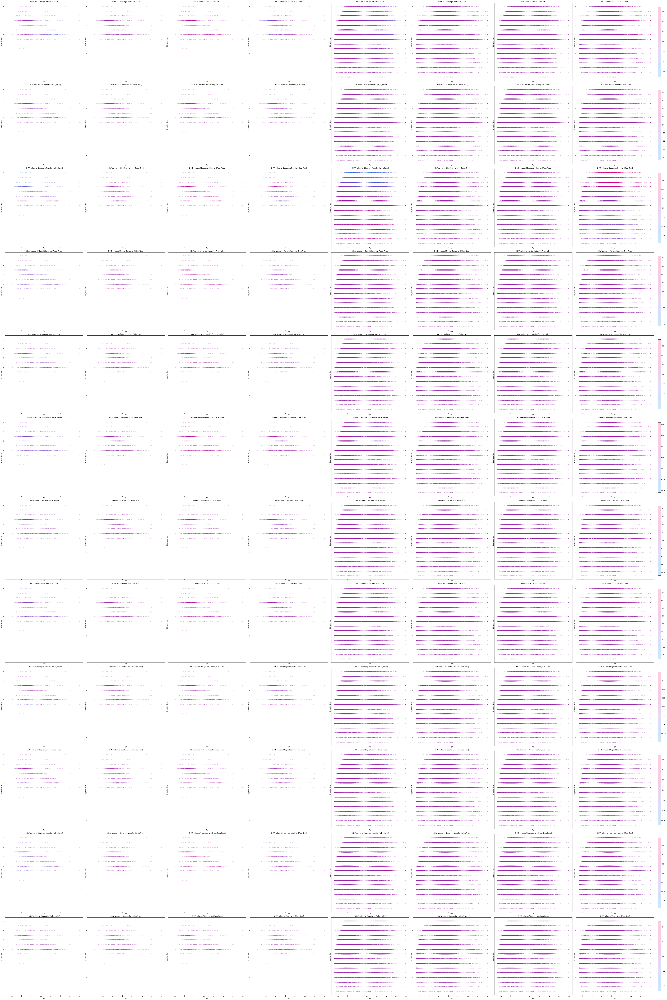

In [13]:
plot_2d(explanations.mclass_diff.labels[is_pred_diff], explanations.mclass_diff.labels[~is_pred_diff], x='Age', y='Education-Num', alpha=0.2)

## Feature importance

### Individual explanations

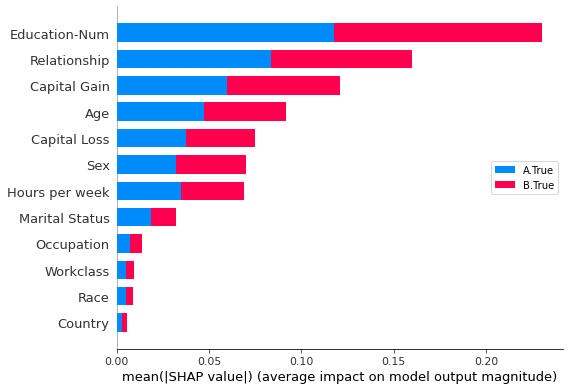

In [14]:
plot_feature_importance_bar(explanations.indiv.labels[:, :, 1])

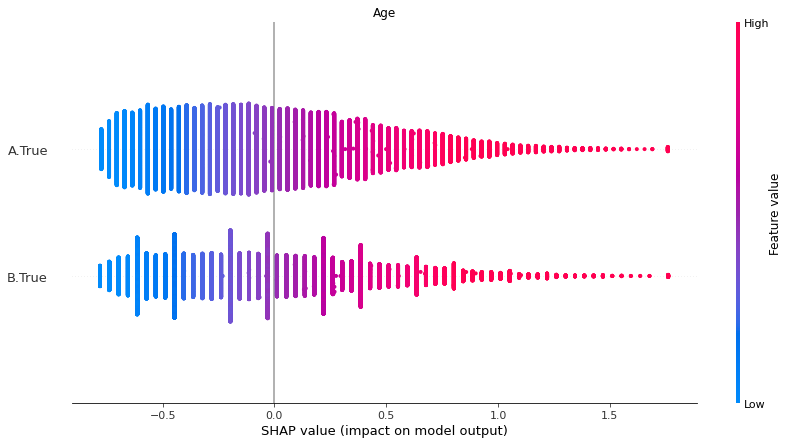

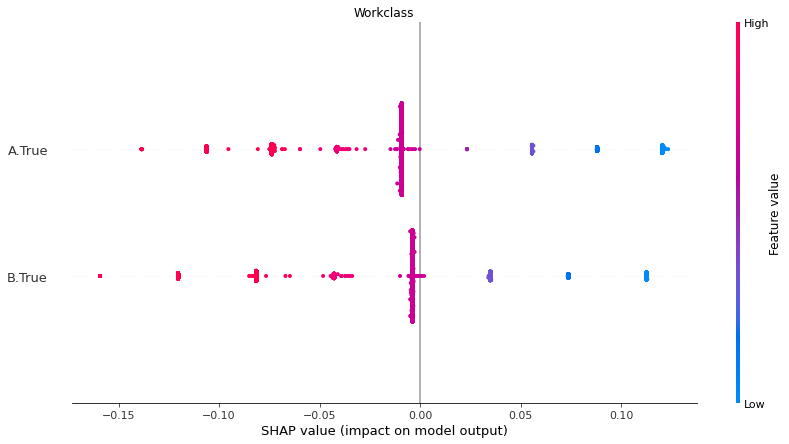

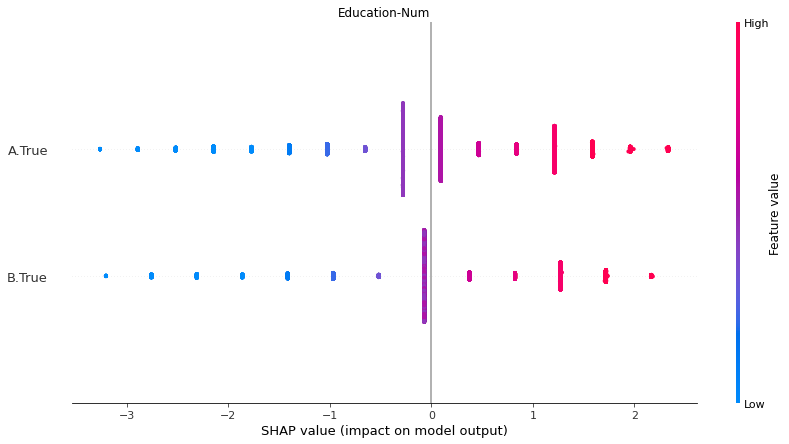

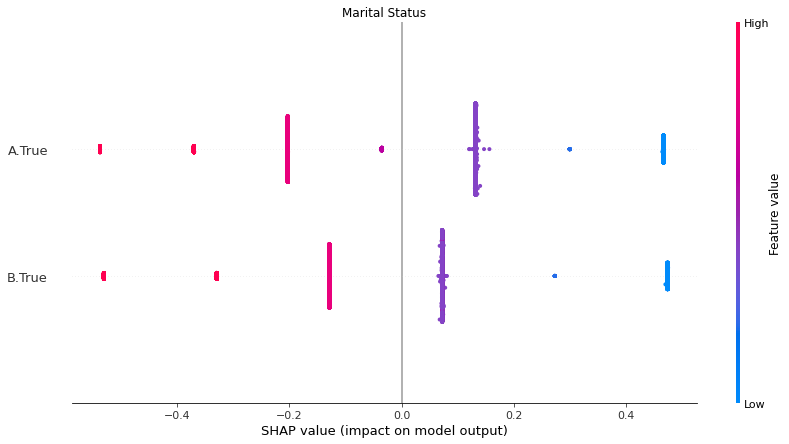

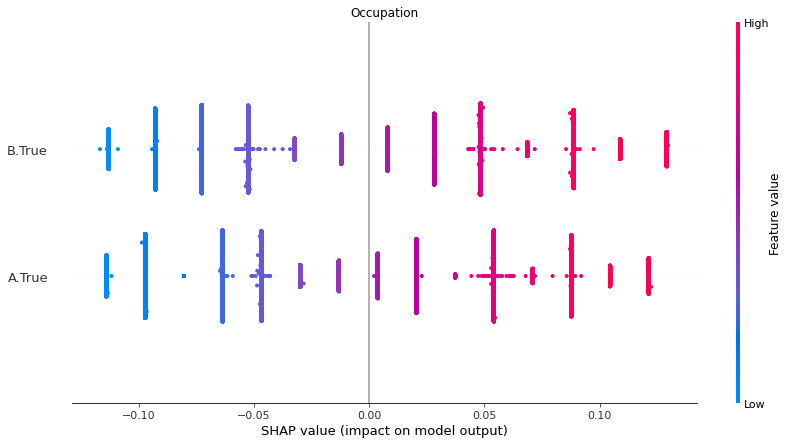

...

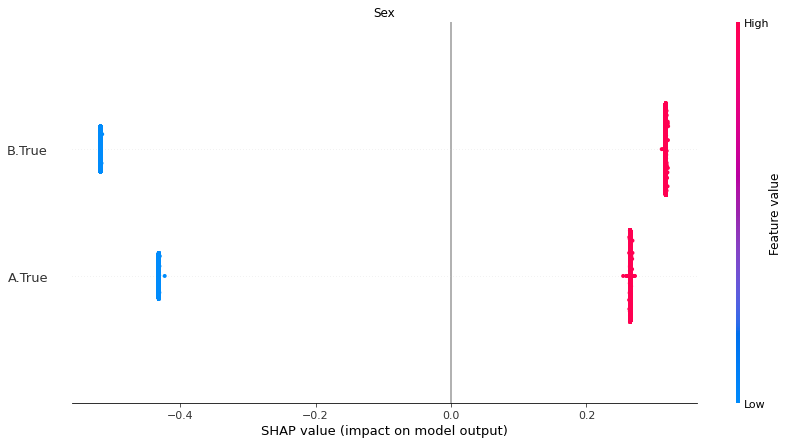

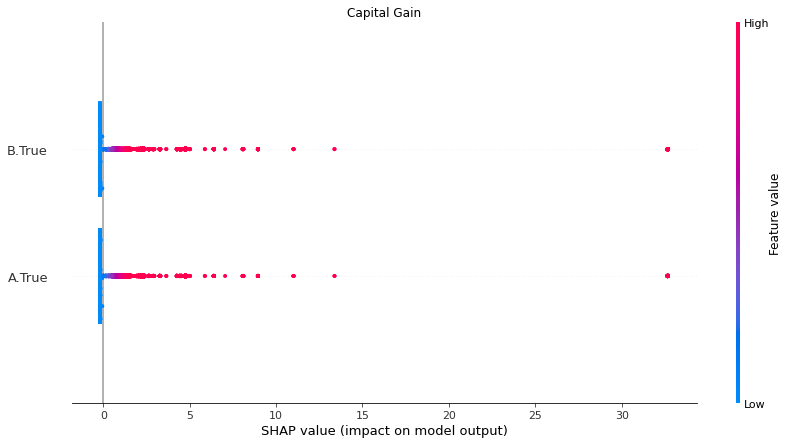

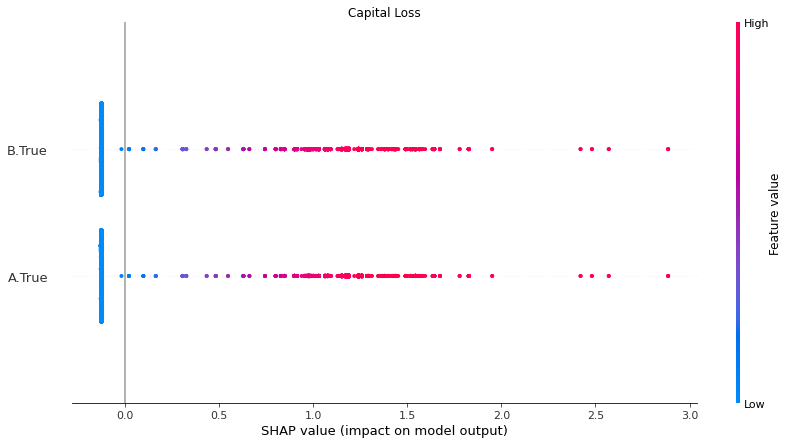

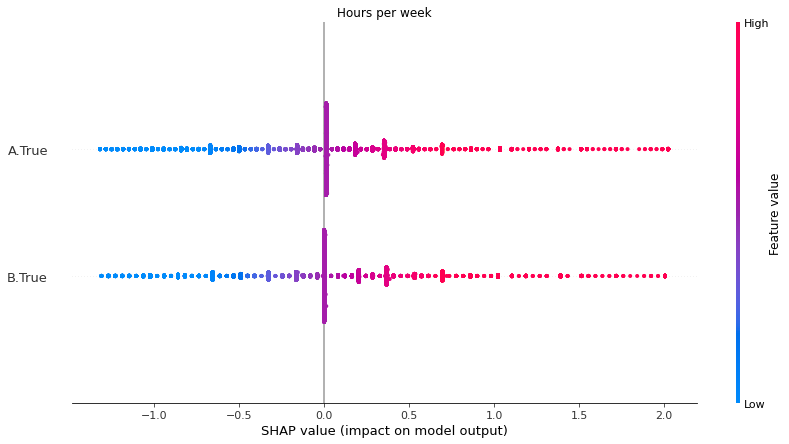

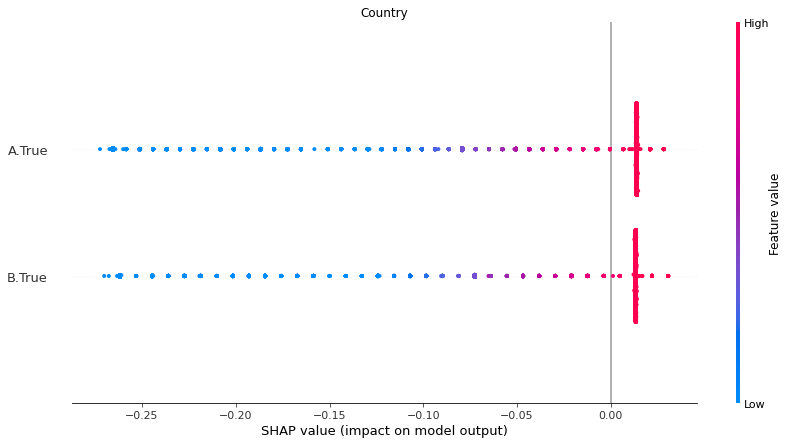

In [15]:
plot_feature_importance_scatter(explanations.indiv.log_odds[:, :, 1])

### Simple subtraction explanation

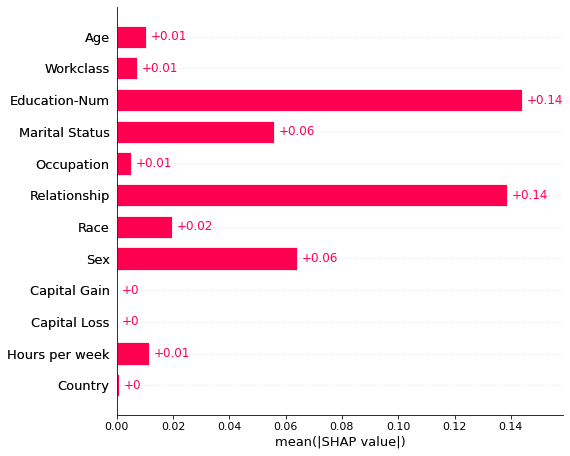

In [16]:
plot_feature_importance_bar(explanations.indiv_diff.log_odds[:, :, 1])

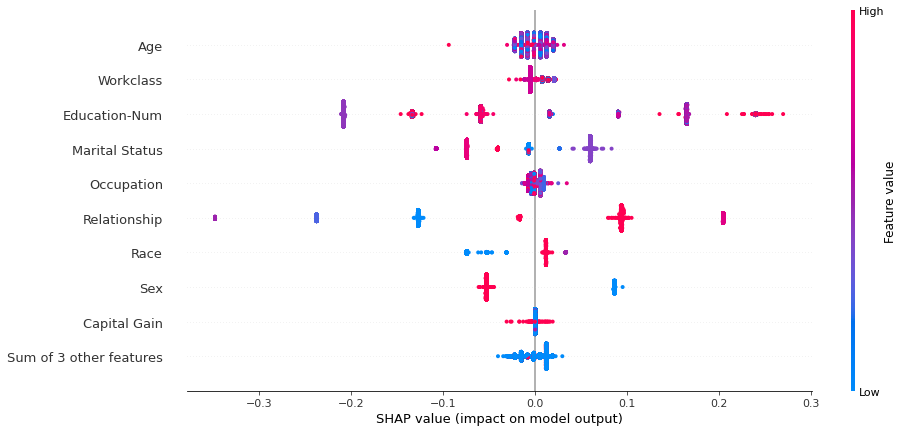

In [17]:
plot_feature_importance_scatter(explanations.indiv_diff.log_odds[:, :, 1])

### Multiclass difference classifier explanations

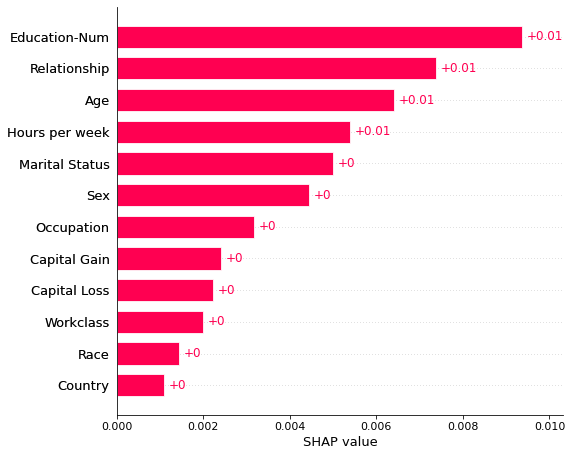

In [18]:
feature_order, feature_importance = calc_feature_order(explanations.mclass_diff.labels[:, :, comparer.difference_class_names])
plot_feature_importance_bar(feature_importance)

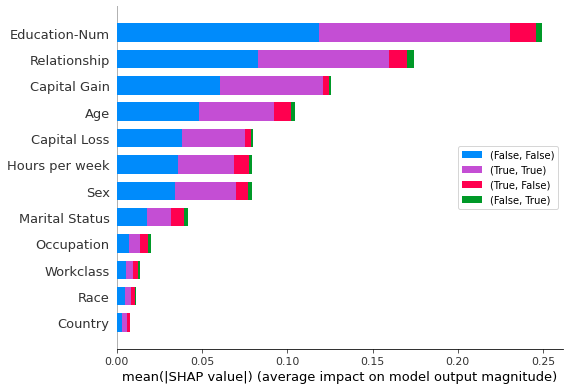

In [19]:
plot_feature_importance_bar(explanations.mclass_diff.labels)

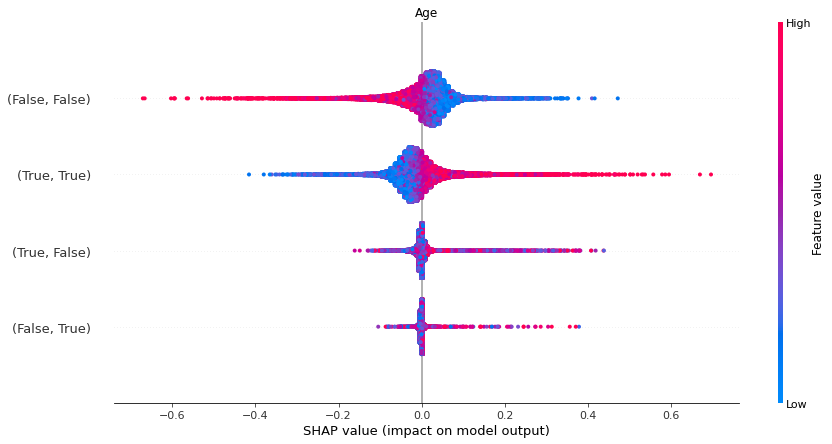

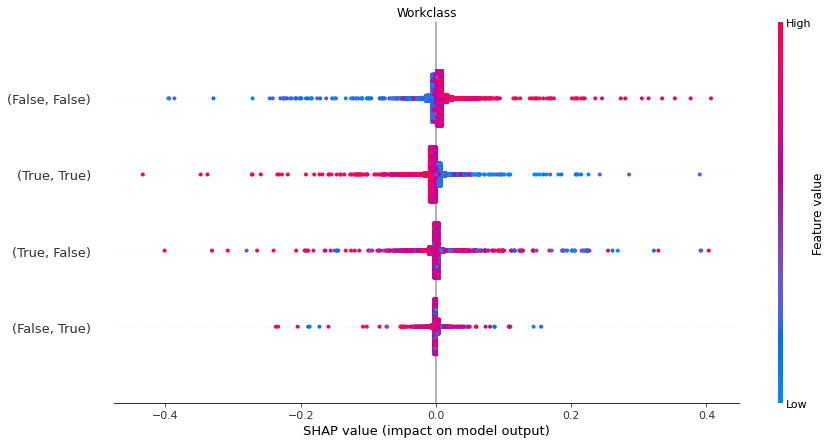

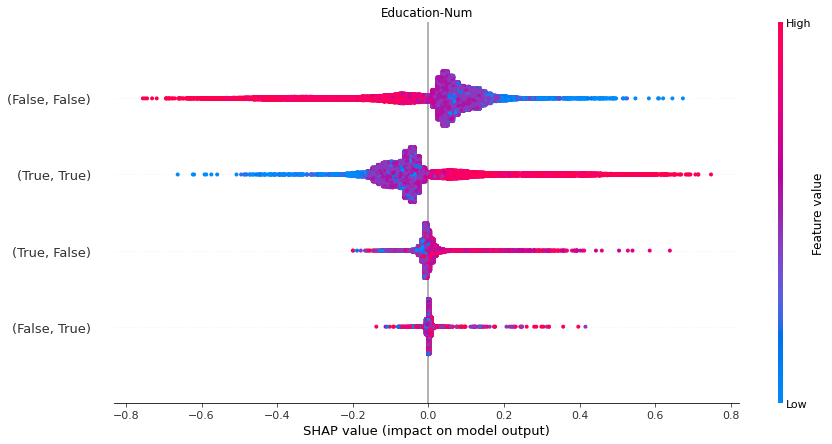

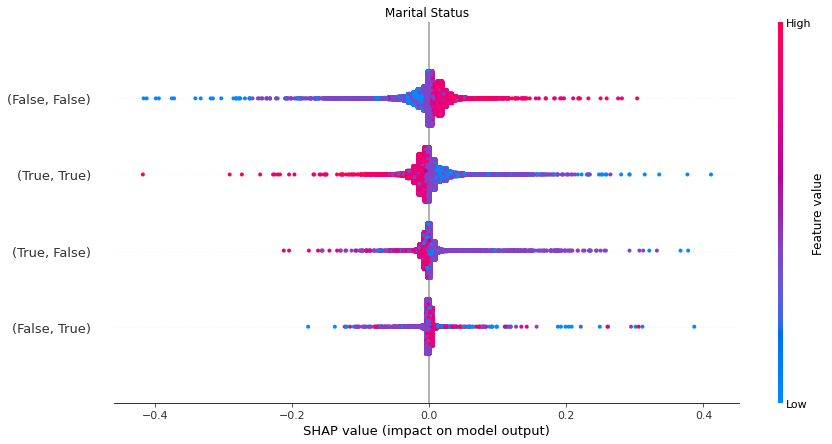

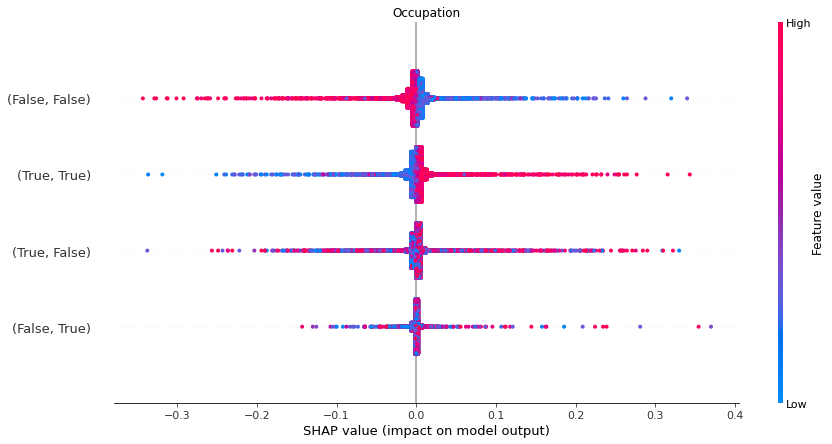

...

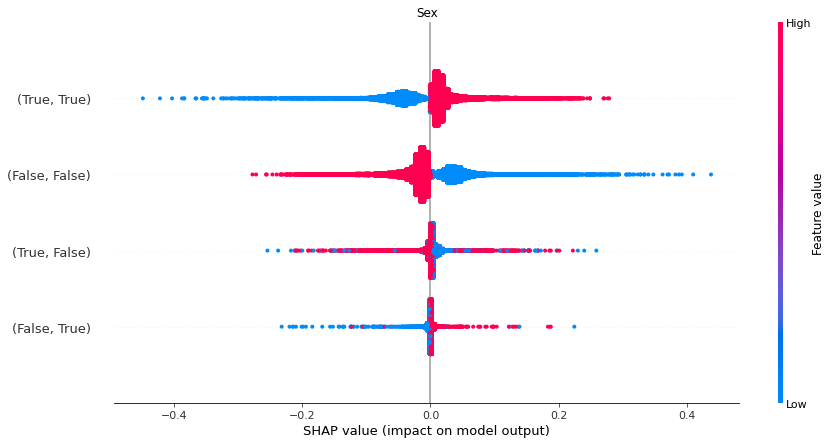

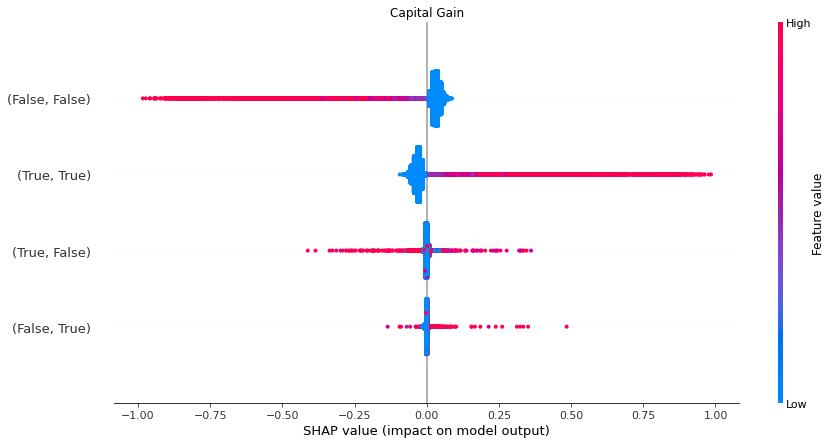

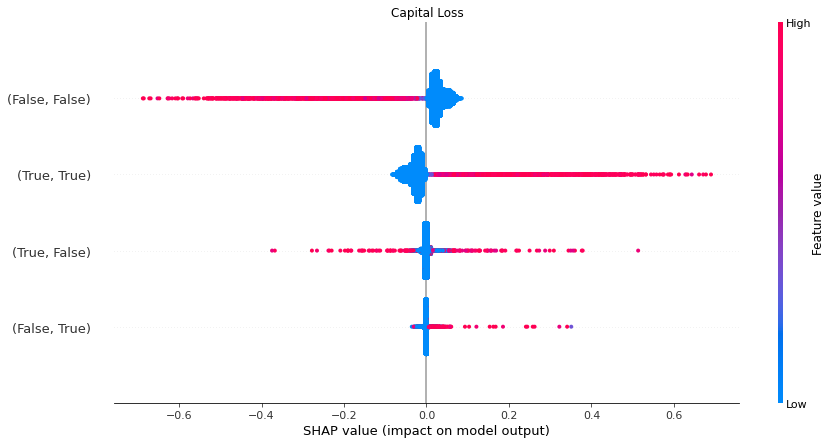

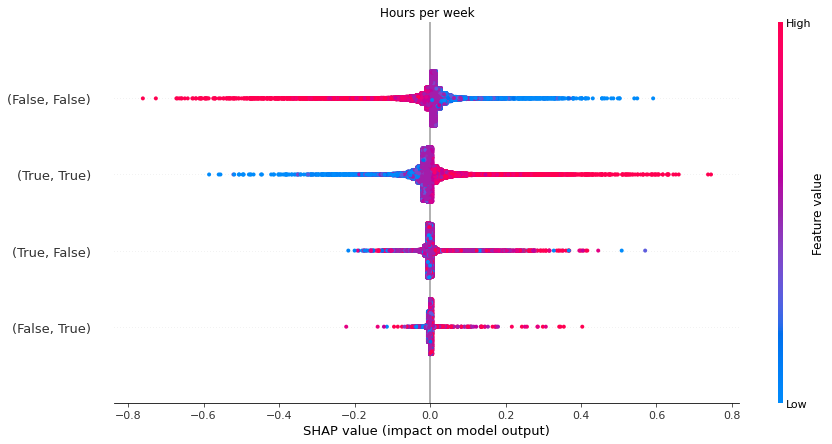

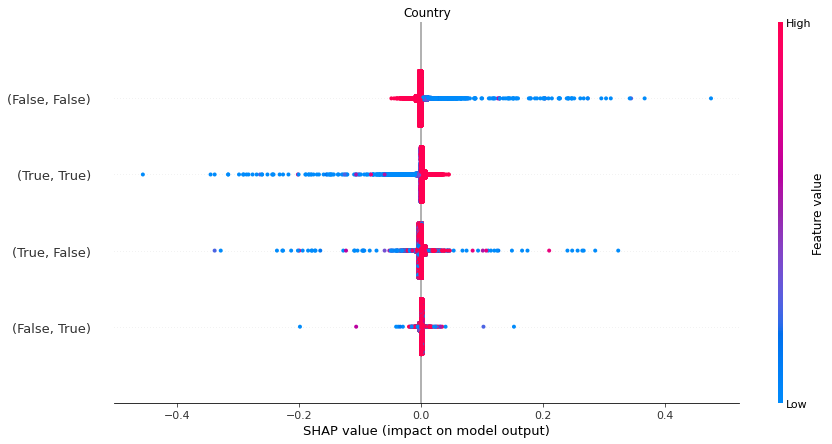

In [3]:
plot_feature_importance_scatter(explanations.mclass_diff.labels)

## Feature effects

### Individual explanations

Passing the fontdict parameter of _set_ticklabels() positionally is deprecated since Matplotlib 3.3; the parameter will become keyword-only two minor releases later.


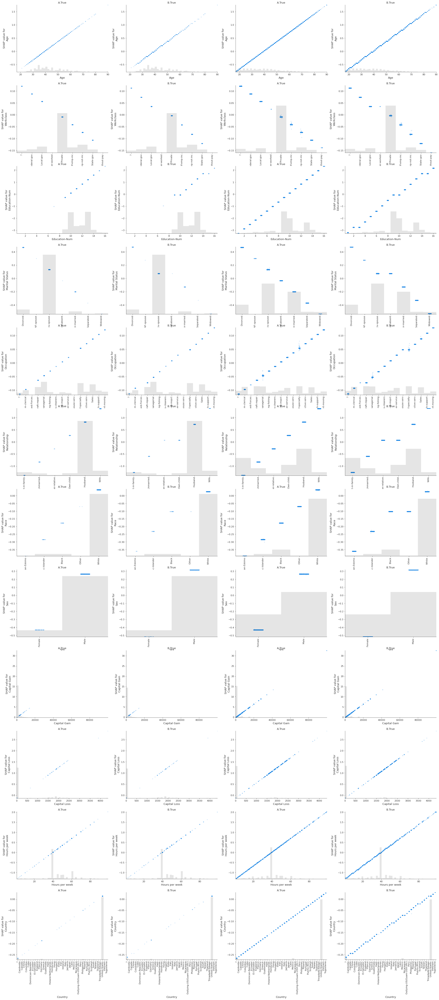

In [21]:
is_pred_diff = comparer.predict_bin_diff(explanations.data)
plot_feature_effects(explanations.indiv.log_odds[is_pred_diff, :, 1], explanations.indiv.log_odds[~is_pred_diff, :, 1], alpha=0.2)

### Simple subtraction explanation

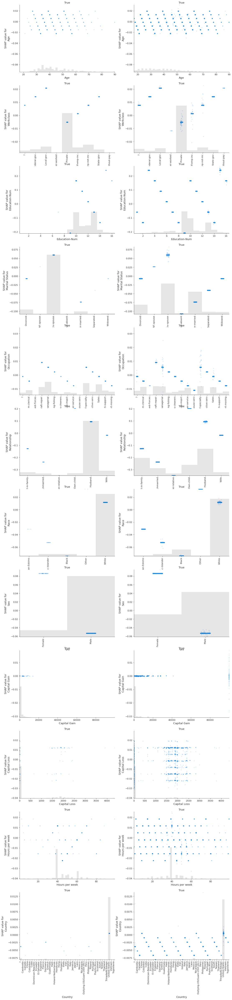

In [22]:
plot_feature_effects(explanations.indiv_diff.log_odds[is_pred_diff, :, 1], explanations.indiv_diff.log_odds[~is_pred_diff, :, 1], alpha=0.2)

### Multiclass difference classifier explanations

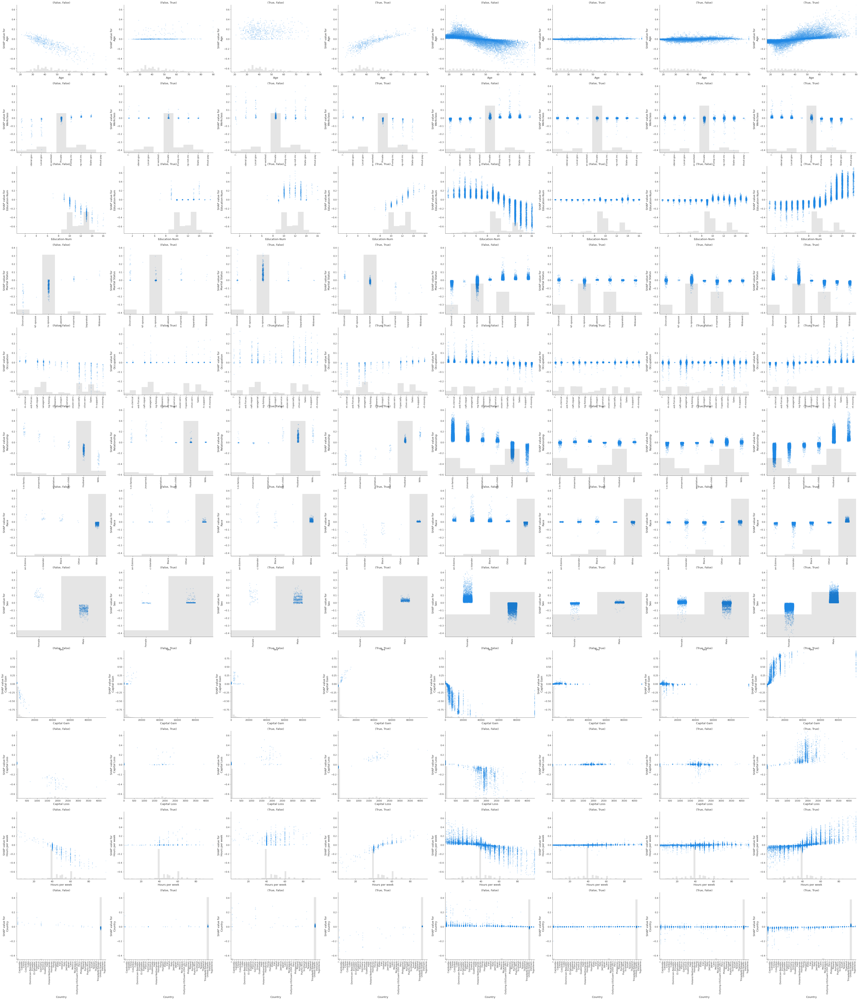

In [23]:
plot_feature_effects(explanations.mclass_diff.labels[is_pred_diff], explanations.mclass_diff.labels[~is_pred_diff], alpha=0.2)

## Cluster instances

### Individual explanations

In [4]:
n_samples = 1000
if explanations.shape[0] > n_samples:
    is_pred_diff = comparer.predict_bin_diff(explanations.data)
    is_pred_diff_indices = np.where(is_pred_diff)[0]
    is_pred_equal_indices = np.where(~is_pred_diff)[0]
    if len(is_pred_diff_indices) > n_samples/2:
        is_pred_diff_indices = resample(is_pred_diff_indices, replace=False, n_samples=int(n_samples/2), random_state=0)
    if len(is_pred_equal_indices) > n_samples/2:
        is_pred_equal_indices = resample(is_pred_equal_indices, replace=False, n_samples=int(n_samples/2), random_state=0)
    sample_indices = np.concatenate([is_pred_diff_indices, is_pred_equal_indices])
    explanations_sample = explanations[sample_indices]
else:
    explanations_sample = explanations

In [5]:
instance_order = calc_instance_order(explanations_sample)

In [6]:
plot_forces(explanations_sample.indiv.proba[:, :, 1], instance_order=instance_order)

### Simple subtraction explanation

In [7]:
plot_forces(explanations_sample.indiv_diff.proba, instance_order=instance_order)

### Multiclass difference classifier explanations

In [8]:
plot_forces(explanations_sample.bin_diff.labels, instance_order=instance_order)

In [9]:
plot_forces(explanations_sample.mclass_diff.proba[:, :, comparer.difference_class_names], instance_order=instance_order)